# Name: Shrook Ehab Attia
# AI Nasr City Intake 2

### 1- Import Libraries

In [107]:
from tensorflow.keras.datasets import cifar10
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import numpy as np
from tensorflow.keras.utils import to_categorical, plot_model
from tensorflow.keras import models, layers
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping

### 2- Load the data

In [108]:
(train_features, train_labels), (test_features, test_labels) = cifar10.load_data()

### 3- Data Exploration

#### 3.1- Assigning each feature to a specific class name

In [109]:
train_features.shape

(50000, 32, 32, 3)

In [110]:
train_labels.shape

(50000, 1)

In [111]:
train_labels

array([[6],
       [9],
       [9],
       ...,
       [9],
       [1],
       [1]], dtype=uint8)

In [112]:
test_features.shape

(10000, 32, 32, 3)

In [113]:
test_labels.shape

(10000, 1)

In [114]:
test_labels

array([[3],
       [8],
       [8],
       ...,
       [5],
       [1],
       [7]], dtype=uint8)

In [115]:
col_names = ['airplane', 'automobile', 'bird', 'cat', 'deer', 'dog', 'frog', 'horse', 'ship', 'truck']
#columns = {0: 'airplane', 1: 'automobile', 2: 'bird', 3: 'cat', 4: 'deer', 5: 'dog', 6: 'frog', 7: 'horse', 8: 'ship', 9: 'truck'}

In [116]:
data_train = {name: [] for i, name in enumerate(col_names)}
data_test = {name: [] for i, name in enumerate(col_names)}

In [117]:
for idx, name in enumerate(col_names):
    for i in range(len(train_labels)):
        if train_labels[i] == idx:
            data_train[name].append(train_features[i])
data_train

{'airplane': [array([[[202, 204, 199],
          [202, 204, 199],
          [204, 206, 201],
          ...,
          [207, 208, 200],
          [205, 206, 199],
          [203, 204, 198]],
  
         [[206, 208, 203],
          [206, 208, 203],
          [207, 209, 204],
          ...,
          [210, 211, 205],
          [208, 209, 203],
          [206, 207, 201]],
  
         [[210, 212, 207],
          [211, 213, 208],
          [212, 214, 210],
          ...,
          [214, 214, 210],
          [212, 213, 208],
          [210, 211, 206]],
  
         ...,
  
         [[218, 217, 222],
          [210, 209, 214],
          [194, 194, 198],
          ...,
          [243, 242, 247],
          [244, 242, 247],
          [243, 243, 247]],
  
         [[219, 218, 223],
          [217, 216, 221],
          [216, 216, 220],
          ...,
          [241, 240, 245],
          [241, 240, 245],
          [241, 240, 245]],
  
         [[217, 216, 221],
          [216, 215, 220],
          [2

In [118]:
for idx, name in enumerate(col_names):
    for i in range(len(test_labels)):
        if test_labels[i] == idx:
            data_test[name].append(test_features[i])
data_test

{'airplane': [array([[[155, 156, 149],
          [167, 176, 187],
          [176, 179, 193],
          ...,
          [201, 196, 209],
          [202, 202, 212],
          [192, 183, 171]],
  
         [[153, 155, 157],
          [163, 179, 204],
          [171, 184, 215],
          ...,
          [202, 208, 222],
          [203, 215, 227],
          [189, 190, 183]],
  
         [[155, 154, 153],
          [160, 178, 201],
          [168, 185, 213],
          ...,
          [206, 208, 215],
          [204, 215, 224],
          [189, 191, 184]],
  
         ...,
  
         [[ 89,  79,  62],
          [ 57,  53,  52],
          [ 61,  61,  59],
          ...,
          [ 89, 119, 101],
          [ 59,  79,  62],
          [ 67,  74,  50]],
  
         [[ 89,  82,  62],
          [ 60,  58,  53],
          [ 63,  66,  58],
          ...,
          [ 57,  66,  58],
          [ 61,  64,  54],
          [ 75,  69,  51]],
  
         [[ 92,  78,  64],
          [ 60,  52,  51],
          [ 

#### 3.2 Visualize 10 examples of each class

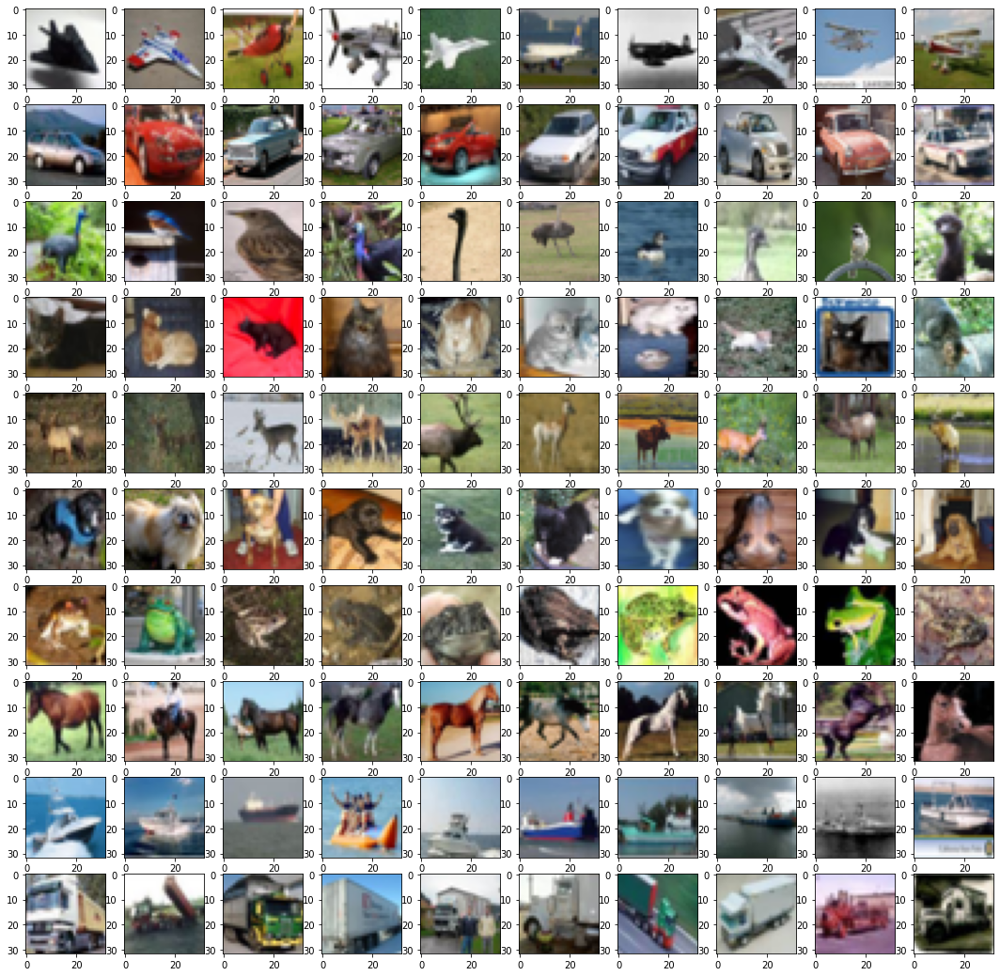

In [119]:
fig = plt.figure(0)
fig.set_size_inches(18.5, 18.5)
for idx, name in enumerate(col_names):
    for j in range(10):
        image = data_train.get(name)[j]
        plt.subplot2grid((10,10), (idx,j))
        plt.imshow(image)

#### 3.3 Histogram

In [120]:
data_train_count = {name: 0 for i, name in enumerate(col_names)}
data_test_count = {name: 0 for i, name in enumerate(col_names)}

In [121]:
for idx, name in enumerate(col_names):
    for i in range(len(train_labels)):
        if train_labels[i] == idx:
            data_train_count[name] = data_train_count[name] + 1
data_train_count

{'airplane': 5000,
 'automobile': 5000,
 'bird': 5000,
 'cat': 5000,
 'deer': 5000,
 'dog': 5000,
 'frog': 5000,
 'horse': 5000,
 'ship': 5000,
 'truck': 5000}

In [122]:
for idx, name in enumerate(col_names):
    for i in range(len(test_labels)):
        if test_labels[i] == idx:
            data_test_count[name] = data_test_count[name] + 1
data_test_count

{'airplane': 1000,
 'automobile': 1000,
 'bird': 1000,
 'cat': 1000,
 'deer': 1000,
 'dog': 1000,
 'frog': 1000,
 'horse': 1000,
 'ship': 1000,
 'truck': 1000}

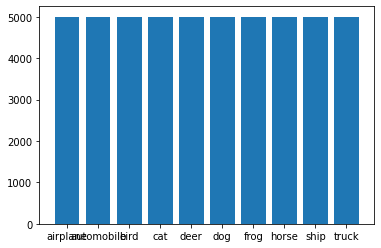

In [123]:
#plt.hist(data_train_count.values(), density=True, bins= 10, histtype='bar', label=col_names)
plt.bar(col_names, data_train_count.values())
plt.show()

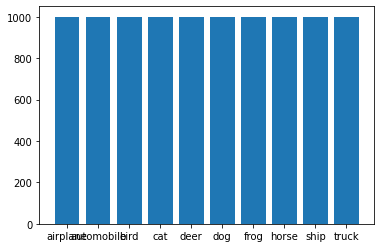

In [124]:
plt.bar(col_names, data_test_count.values())
plt.show()

#### 3.4 Reshaping features and converting labels to one hot encoded

In [125]:
#train_features = train_features.reshape(50000, 32 * 32 * 3)
#test_features = test_features.reshape(10000, 32 * 32 * 3)

train_features = train_features.astype('float32') / 255.0
test_features = test_features.astype('float32') / 255.0

In [126]:
train_features.shape

(50000, 32, 32, 3)

In [127]:
test_features.shape

(10000, 32, 32, 3)

In [128]:
train_labels = to_categorical(train_labels)
test_labels = to_categorical(test_labels)

In [129]:
train_labels

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 1.],
       [0., 0., 0., ..., 0., 0., 1.],
       ...,
       [0., 0., 0., ..., 0., 0., 1.],
       [0., 1., 0., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.]], dtype=float32)

In [130]:
train_labels.shape

(50000, 10)

In [131]:
test_labels

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 0., 1., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 1., 0., 0.]], dtype=float32)

In [132]:
test_labels.shape

(10000, 10)

### 4- Data Spliting

In [133]:
features_train, features_val, labels_train, labels_val = train_test_split(train_features, train_labels, random_state=42, test_size=0.2, shuffle=True)

### 5- Modeling

In [135]:
# Train and test a model with 3 fully connected layers with the following architecture: 512-256-128

network = models.Sequential()

network.add(layers.Conv2D(32,(3,3), activation='relu', name='Layer_1', input_shape=(32,32,3)))
network.add(layers.MaxPooling2D((2,2)))
network.add(layers.Conv2D(64,(3,3), activation='relu', name='Layer_2'))
network.add(layers.MaxPooling2D((2,2)))
network.add(layers.Conv2D(64,(3,3), activation='relu', name='Layer_3'))
network.add(layers.Flatten())
network.add(layers.Dense(64, activation='relu', name='Layer_4'))
network.add(layers.Dense(10, activation='softmax', name='Layer_5'))

In [136]:
network.summary()

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Layer_1 (Conv2D)            (None, 30, 30, 32)        896       
                                                                 
 max_pooling2d_8 (MaxPooling  (None, 15, 15, 32)       0         
 2D)                                                             
                                                                 
 Layer_2 (Conv2D)            (None, 13, 13, 64)        18496     
                                                                 
 max_pooling2d_9 (MaxPooling  (None, 6, 6, 64)         0         
 2D)                                                             
                                                                 
 Layer_3 (Conv2D)            (None, 4, 4, 64)          36928     
                                                                 
 flatten_4 (Flatten)         (None, 1024)             

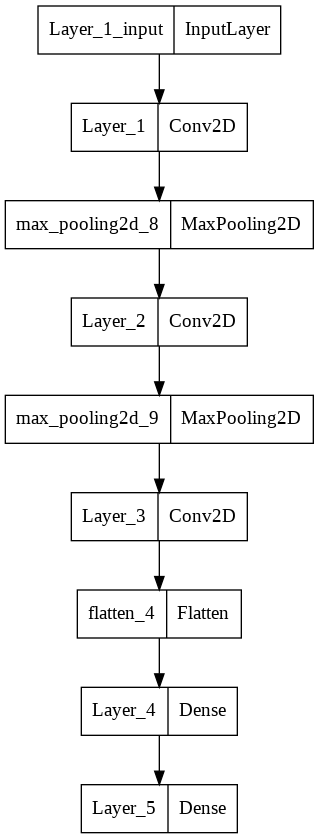

In [137]:
plot_model(network)

In [138]:
# Use adam optimizer with learning rate=10e-3
network_optimizer = Adam(learning_rate=10e-3)

In [139]:
network.compile(optimizer=network_optimizer, loss='categorical_crossentropy', metrics=['accuracy'])

In [140]:
network_history = network.fit(features_train, labels_train, epochs=20, batch_size=128, validation_data=(features_val, labels_val), callbacks=[EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=5)])

Epoch 1/20
313/313 [==============================] - 52s 163ms/step - loss: 1.9084 - accuracy: 0.2860 - val_loss: 1.6134 - val_accuracy: 0.4049
Epoch 2/20
313/313 [==============================] - 54s 172ms/step - loss: 1.6249 - accuracy: 0.4005 - val_loss: 1.5762 - val_accuracy: 0.4219
Epoch 3/20
313/313 [==============================] - 50s 161ms/step - loss: 1.5424 - accuracy: 0.4319 - val_loss: 1.5124 - val_accuracy: 0.4488
Epoch 4/20
313/313 [==============================] - 51s 165ms/step - loss: 1.5018 - accuracy: 0.4526 - val_loss: 1.4748 - val_accuracy: 0.4588
Epoch 5/20
313/313 [==============================] - 50s 161ms/step - loss: 1.4659 - accuracy: 0.4654 - val_loss: 1.4627 - val_accuracy: 0.4649
Epoch 6/20
313/313 [==============================] - 50s 161ms/step - loss: 1.4405 - accuracy: 0.4770 - val_loss: 1.5395 - val_accuracy: 0.4419
Epoch 7/20
313/313 [==============================] - 50s 161ms/step - loss: 1.4104 - accuracy: 0.4884 - val_loss: 1.4405 - val_ac

In [141]:
test_loss, test_accuracy = network.evaluate(test_features, test_labels)

313/313 [==============================] - 4s 14ms/step - loss: 1.3735 - accuracy: 0.5072


In [142]:
history_dict = network_history.history
history_dict.keys()

dict_keys(['loss', 'accuracy', 'val_loss', 'val_accuracy'])

In [143]:
accuracy_value = network_history.history['accuracy']
val_accuracy_value = network_history.history['val_accuracy']
loss_value = network_history.history['loss']
val_loss_value = network_history.history['val_loss']
epochs = range(1, len(accuracy_value) + 1)

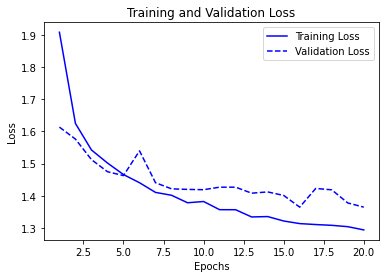

In [144]:
plt.plot(epochs, loss_value, 'b', label='Training Loss')
plt.plot(epochs, val_loss_value, 'b', linestyle='dashed', label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

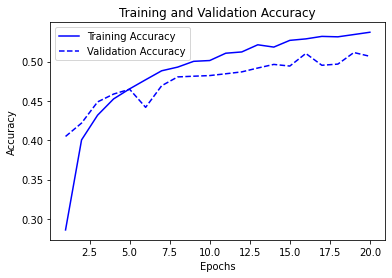

In [145]:
plt.plot(epochs, accuracy_value, 'b', label='Training Accuracy')
plt.plot(epochs, val_accuracy_value, 'b', linestyle='dashed', label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()